# 0. Imports

In [1]:
import sys

sys.path.append("../src/")

from utils import mape, mean_std_cross_val_scores

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.dummy import DummyRegressor
from sklearn.preprocessing import OneHotEncoder, StandardScaler 
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.metrics import make_scorer, mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.model_selection import cross_val_score, cross_validate, train_test_split, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from xgboost import XGBRegressor
from lightgbm.sklearn import LGBMRegressor
from catboost import CatBoostRegressor
import matplotlib.pyplot as plt
import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from tqdm import tqdm
from scipy.stats import expon, lognorm, loguniform, randint, uniform
import plotly.graph_objects as go
import joblib

# 1. Data

In [2]:
df = pd.read_csv(
    "../data/processed/seoul_fine_dust_weather_2008_2021_for_ml.csv", 
    index_col=0, 
    parse_dates=True
).reset_index()

In [3]:
df.head()

,date,temp(°C),precipitation(mm),wind_speed(m/s),wind_direction,humidity(%),local_P(hPa),cloud_cover,lowest_ceiling(100m),month,PM10_Counts,PM25_Counts,log_PM10_Counts,log_PM25_Counts
0,2008-01-01 10:00:00,-7.6,0.0,4.6,340.0,47.0,1010.7,2.0,12.0,1,30.0,11.0,3.401197,2.397895
1,2008-01-01 11:00:00,-6.9,0.0,4.1,290.0,42.0,1010.7,2.0,12.0,1,29.0,13.0,3.367296,2.564949
2,2008-01-01 12:00:00,-5.8,0.0,4.1,290.0,42.0,1010.7,2.0,12.0,1,29.0,12.0,3.367296,2.484907
3,2008-01-01 13:00:00,-5.0,0.0,4.1,290.0,36.0,1009.9,0.0,10.0,1,28.0,12.0,3.332205,2.484907
4,2008-01-01 14:00:00,-4.4,0.0,4.1,290.0,36.0,1009.9,0.0,10.0,1,27.0,13.0,3.295837,2.564949


In [4]:
df["month"] = df["month"].astype("category")

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122733 entries, 0 to 122732
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   date                  122733 non-null  datetime64[ns]
 1   temp(°C)              122733 non-null  float64       
 2   precipitation(mm)     122733 non-null  float64       
 3   wind_speed(m/s)       122733 non-null  float64       
 4   wind_direction        122733 non-null  float64       
 5   humidity(%)           122733 non-null  float64       
 6   local_P(hPa)          122733 non-null  float64       
 7   cloud_cover           122733 non-null  float64       
 8   lowest_ceiling(100m)  122733 non-null  float64       
 9   month                 122733 non-null  category      
 10  PM10_Counts           122733 non-null  float64       
 11  PM25_Counts           122733 non-null  float64       
 12  log_PM10_Counts       122733 non-null  float64       
 13 

# 2. Train/Test Split

In [6]:
train_df = df.query("date < '2016-01-01 00:00:00'")
test_df = df.query("date >= '2016-01-01 00:00:00'")

train_df.set_index("date", inplace=True)
test_df.set_index("date", inplace=True)

In [7]:
train_df.tail()

,temp(°C),precipitation(mm),wind_speed(m/s),wind_direction,humidity(%),local_P(hPa),cloud_cover,lowest_ceiling(100m),month,PM10_Counts,PM25_Counts,log_PM10_Counts,log_PM25_Counts
date,,,,,,,,,,,,,
2015-12-31 05:00:00,0.7,0.0,1.3,180.0,91.0,1016.9,7.0,10.0,12,54.0,35.0,3.988984,3.555348
2015-12-31 06:00:00,0.7,0.0,2.7,340.0,92.0,1017.5,9.0,10.0,12,48.0,34.0,3.871201,3.526361
2015-12-31 07:00:00,0.6,0.0,1.9,360.0,91.0,1018.1,7.0,10.0,12,48.0,33.0,3.871201,3.496508
2015-12-31 08:00:00,0.6,0.0,2.2,360.0,90.0,1018.9,10.0,9.0,12,45.0,31.0,3.806662,3.433987
2015-12-31 09:00:00,0.6,0.0,2.5,360.0,88.0,1019.8,8.0,9.0,12,44.0,30.0,3.784190,3.401197


In [8]:
test_df.head()

,temp(°C),precipitation(mm),wind_speed(m/s),wind_direction,humidity(%),local_P(hPa),cloud_cover,lowest_ceiling(100m),month,PM10_Counts,PM25_Counts,log_PM10_Counts,log_PM25_Counts
date,,,,,,,,,,,,,
2016-01-01 00:00:00,-1.9,0.0,0.1,0.0,85.0,1022.1,0.0,10.0,1,90.0,61.0,4.499810,4.110874
2016-01-01 10:00:00,-0.6,0.0,1.1,90.0,72.0,1022.7,6.0,10.0,1,81.0,54.0,4.394449,3.988984
2016-01-01 11:00:00,1.5,0.0,1.3,140.0,70.0,1022.5,8.0,10.0,1,84.0,56.0,4.430817,4.025352
2016-01-01 12:00:00,2.2,0.0,1.9,140.0,66.0,1021.4,9.0,10.0,1,85.0,59.0,4.442651,4.077537
2016-01-01 13:00:00,3.1,0.0,1.3,140.0,60.0,1020.1,8.0,10.0,1,82.0,56.0,4.406719,4.025352


In [9]:
X_train = train_df.drop(
    columns=["PM10_Counts", "PM25_Counts", "log_PM10_Counts", "log_PM25_Counts"]
)
y_train = train_df["log_PM10_Counts"]

X_test = test_df.drop(
    columns=["PM10_Counts", "PM25_Counts", "log_PM10_Counts", "log_PM25_Counts"]
)
y_test = test_df["log_PM10_Counts"]

# 3. Feature Selection

In [10]:
numerical_features = list(X_train.columns)
numerical_features.remove("month")
numerical_features

['temp(°C)',
 'precipitation(mm)',
 'wind_speed(m/s)',
 'wind_direction',
 'humidity(%)',
 'local_P(hPa)',
 'cloud_cover',
 'lowest_ceiling(100m)']

In [11]:
categorical_feature = ["month"]

In [12]:
ct = make_column_transformer(
    (
        StandardScaler(),
        numerical_features
    ),
    (
        OneHotEncoder(handle_unknown="ignore"),
        categorical_feature
    ),
)

# 4. Hyperparameter Optimization

In [13]:
# LGBM Model Before Optimization
random_state = 123

pipe_lgbm_before = make_pipeline(ct, LGBMRegressor(random_state=random_state))

In [14]:
# Parameter for Optimization

random_param_grid = {
    'lgbmregressor__num_leaves': randint(6, 120),
    'lgbmregressor__max_depth': randint(5, 100), 
    'lgbmregressor__min_child_samples': randint(5, 500), 
    'lgbmregressor__min_child_weight': loguniform(1e-5, 1e4),
    'lgbmregressor__subsample': uniform(loc=0.2, scale=0.8), 
    'lgbmregressor__colsample_bytree': uniform(loc=0.4, scale=0.6),
    'lgbmregressor__reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
    'lgbmregressor__reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]
}

In [15]:
random_search = RandomizedSearchCV(
    pipe_lgbm_before,
    param_distributions=random_param_grid,
    n_jobs=-1,
    n_iter=50,
    cv=10,
    random_state=random_state,
    scoring='neg_mean_absolute_error'
)

In [16]:
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=10,
                   estimator=Pipeline(steps=[('columntransformer',
                                              ColumnTransformer(transformers=[('standardscaler',
                                                                               StandardScaler(),
                                                                               ['temp(°C)',
                                                                                'precipitation(mm)',
                                                                                'wind_speed(m/s)',
                                                                                'wind_direction',
                                                                                'humidity(%)',
                                                                                'local_P(hPa)',
                                                                                'cloud_cover',
                                                                                'lowest_ceiling(100m)']),
                                                                              ('onehotencoder',
                                                                               OneHotEncoder(handle_unknown='ignore'),
                                                                               ['month'])])),
                                             ('lgbm...
                                        'lgbmregressor__num_leaves': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x0000020E6C444550>,
                                        'lgbmregressor__reg_alpha': [0, 0.1, 1,
                                                                     2, 5, 7,
                                                                     10, 50,
                                                                     100],
                                        'lgbmregressor__reg_lambda': [0, 0.1, 1,
                                                                      5, 10, 20,
                                                                      50, 100],
                                        'lgbmregressor__subsample': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x0000020E6C444D00>},
                   random_state=123, scoring='neg_mean_absolute_error')

In [17]:
pd.DataFrame(random_search.cv_results_).set_index("rank_test_score").sort_index().T

rank_test_score,1,2,3,4,5,6,7,8,9,10,...,41,42,43,44,45,46,47,48,49,50
mean_fit_time,1.114101,1.0441,0.936401,1.3081,1.155499,1.1665,1.2191,1.0873,1.027001,1.432399,...,0.7465,0.8558,0.729501,0.6894,0.7668,0.6962,0.922099,0.7969,0.7051,0.7181
std_fit_time,0.099629,0.090872,0.06499,0.105445,0.071188,0.096471,0.112029,0.084467,0.095307,0.102622,...,0.039091,0.070434,0.061129,0.060042,0.100061,0.093247,0.105012,0.092691,0.085393,0.091147
mean_score_time,0.0951,0.100401,0.0819,0.1421,0.1293,0.1116,0.1278,0.1217,0.0993,0.1497,...,0.056701,0.064001,0.056899,0.045701,0.054799,0.051101,0.0587,0.0615,0.0524,0.0587
std_score_time,0.020821,0.020431,0.015035,0.020101,0.027376,0.017136,0.013083,0.018947,0.023256,0.059204,...,0.010991,0.00873,0.015358,0.002685,0.007998,0.012168,0.008775,0.009562,0.008224,0.012116
param_lgbmregressor__colsample_bytree,0.936033,0.692905,0.817882,0.655521,0.648896,0.744438,0.617862,0.617073,0.78154,0.998788,...,0.747131,0.776349,0.638827,0.767737,0.745081,0.491842,0.846778,0.582378,0.638911,0.440065
param_lgbmregressor__max_depth,35,15,71,98,80,26,12,32,43,22,...,74,70,73,54,32,45,25,83,12,5
param_lgbmregressor__min_child_samples,185,141,481,459,443,94,354,295,262,408,...,102,308,310,273,326,414,94,34,491,296
param_lgbmregressor__min_child_weight,0.328496,0.042677,16.518237,0.213421,0.001795,0.000052,25.265402,0.0044,50.469139,0.000041,...,0.000011,0.19653,0.000439,273.569203,0.000089,0.007394,6948.340951,6519.932229,9082.937761,9220.97716
param_lgbmregressor__num_leaves,32,31,23,87,49,50,71,46,23,57,...,8,11,8,7,7,6,75,7,19,100
param_lgbmregressor__reg_alpha,0,2,2,7,7,2,5,2,10,10,...,1,100,5,2,50,2,0.1,7,5,50


In [18]:
result = random_search.best_params_
result

{'lgbmregressor__colsample_bytree': 0.9360334978702809,
 'lgbmregressor__max_depth': 35,
 'lgbmregressor__min_child_samples': 185,
 'lgbmregressor__min_child_weight': 0.32849599796402146,
 'lgbmregressor__num_leaves': 32,
 'lgbmregressor__reg_alpha': 0,
 'lgbmregressor__reg_lambda': 50,
 'lgbmregressor__subsample': 0.45382838545625676}

# 5. Comparison of Predictions Before and After Optimization

In [19]:
pipe_lgbm_after = make_pipeline(
    ct, 
    LGBMRegressor(
        random_state=random_state,
        num_leaves=result['lgbmregressor__num_leaves'],
        max_depth=result['lgbmregressor__max_depth'],
        min_child_samples=result['lgbmregressor__min_child_samples'],
        min_child_weight=result['lgbmregressor__min_child_weight'],
        subsample=result['lgbmregressor__subsample'],
        colsample_bytree=result['lgbmregressor__colsample_bytree'],
        reg_alpha=result['lgbmregressor__reg_alpha'],
        reg_lambda=result['lgbmregressor__reg_lambda']
    )
)

In [20]:
results = {}

In [21]:
models = {
    "lgbm_before_opt": pipe_lgbm_before,
    "lgbm_after_opt": pipe_lgbm_after
}

In [22]:
for (name, model) in models.items():
    results[name] = mean_std_cross_val_scores(
        model, X_train, y_train, return_train_score=True, scoring='neg_mean_absolute_error'
    )

In [23]:
pd.DataFrame(results)

,lgbm_before_opt,lgbm_after_opt
fit_time,0.263 (+/- 0.024),0.318 (+/- 0.015)
score_time,0.026 (+/- 0.002),0.032 (+/- 0.003)
test_score,-0.402 (+/- 0.006),-0.399 (+/- 0.008)
train_score,-0.344 (+/- 0.003),-0.349 (+/- 0.003)


# 6. Comparison of Prediction Results

In [24]:
pipe_lgbm_before.fit(X_train, y_train)
pipe_lgbm_after.fit(X_train, y_train)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('standardscaler',
                                                  StandardScaler(),
                                                  ['temp(°C)',
                                                   'precipitation(mm)',
                                                   'wind_speed(m/s)',
                                                   'wind_direction',
                                                   'humidity(%)',
                                                   'local_P(hPa)',
                                                   'cloud_cover',
                                                   'lowest_ceiling(100m)']),
                                                 ('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['month'])])),
                ('lgbmregressor',
                 LGBMRegressor(colsample_bytree=0.9360334978702809,
                               max_depth=35, min_child_samples=185,
                               min_child_weight=0.32849599796402146,
                               num_leaves=32, random_state=123, reg_alpha=0,
                               reg_lambda=50, subsample=0.45382838545625676))])

In [25]:
test_df["prediction_before_opt"] = np.exp(pipe_lgbm_before.predict(X_test))
test_df["prediction_after_opt"] = np.exp(pipe_lgbm_after.predict(X_test))

C:\Users\johnw\AppData\Local\Temp\ipykernel_21868\2544977498.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["prediction_before_opt"] = np.exp(pipe_lgbm_before.predict(X_test))
C:\Users\johnw\AppData\Local\Temp\ipykernel_21868\2544977498.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["prediction_after_opt"] = np.exp(pipe_lgbm_after.predict(X_test))


## 6.1 Hourly Prediction

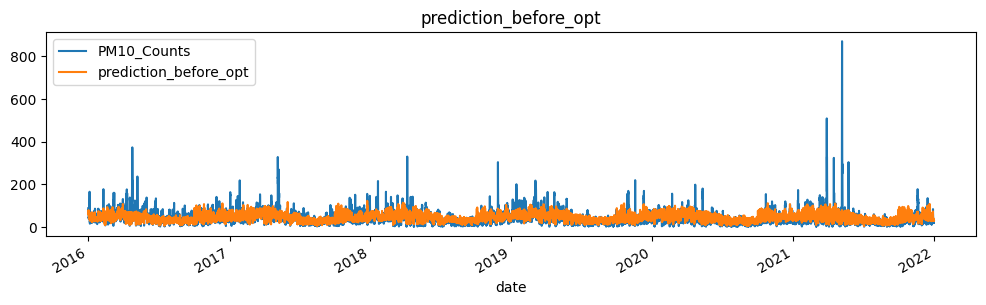

In [26]:
fig = test_df[["PM10_Counts", "prediction_before_opt"]].plot(figsize=(12, 3))
fig.set_title("prediction_before_opt")
plt.show()

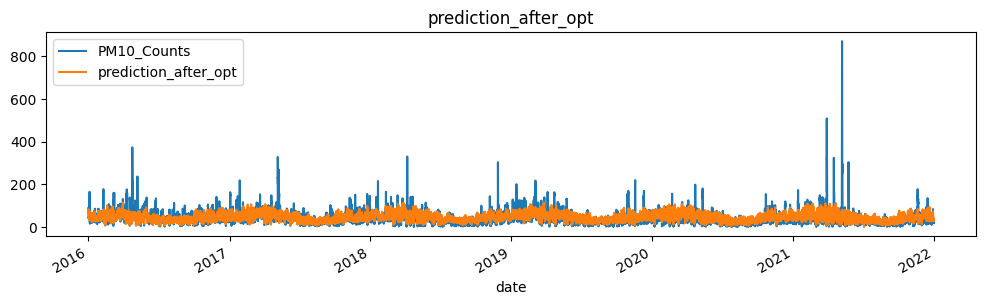

In [27]:
fig = test_df[["PM10_Counts", "prediction_after_opt"]].plot(figsize=(12, 3))
fig.set_title("prediction_after_opt")
plt.show()

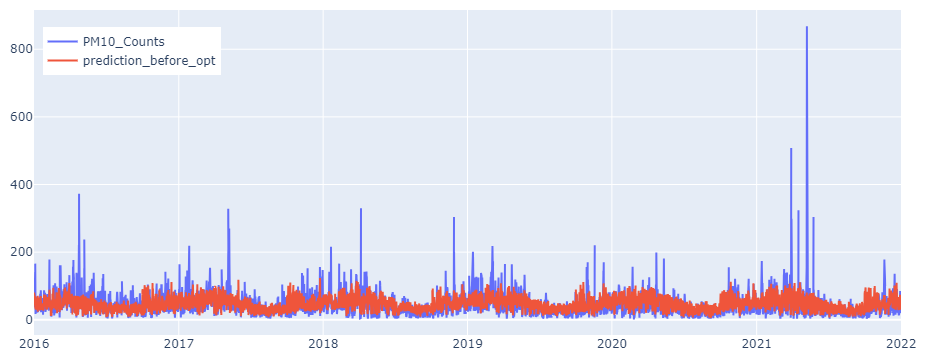

In [28]:
fig = go.Figure()
fig.add_scatter(
    x=test_df.index, 
    y=test_df["PM10_Counts"],
    name="PM10_Counts"
)
fig.add_scatter(
    x=test_df.index, 
    y=test_df["prediction_before_opt"],
    name="prediction_before_opt"
)
fig.update_layout(
    autosize=False,
    width=1000,
    height=300,
    margin=dict(l=10, r=10, t=10, b=10)
)
fig.update_layout(legend=dict(
    yanchor="bottom",
    y=0.8,
    xanchor="left",
    x=0.01
))
fig.show();

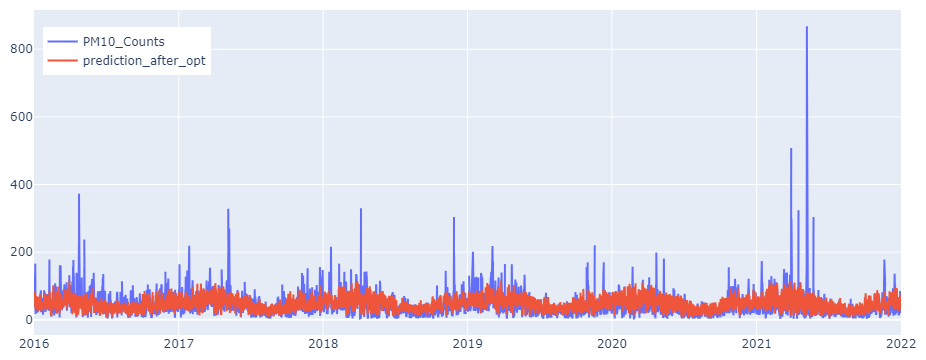

In [29]:
fig = go.Figure()
fig.add_scatter(
    x=test_df.index, 
    y=test_df["PM10_Counts"],
    name="PM10_Counts"
)
fig.add_scatter(
    x=test_df.index, 
    y=test_df["prediction_after_opt"],
    name="prediction_after_opt"
)
fig.update_layout(
    autosize=False,
    width=1000,
    height=300,
    margin=dict(l=10, r=10, t=10, b=10)
)
fig.update_layout(legend=dict(
    yanchor="bottom",
    y=0.8,
    xanchor="left",
    x=0.01
))
fig.show();

## 6.2. Monthly Prediction

In [30]:
test_df_1 = test_df.copy()

In [31]:
test_df_1.reset_index(inplace=True)

In [32]:
test_df_1["year_month"] = test_df_1["date"].dt.to_period('M')

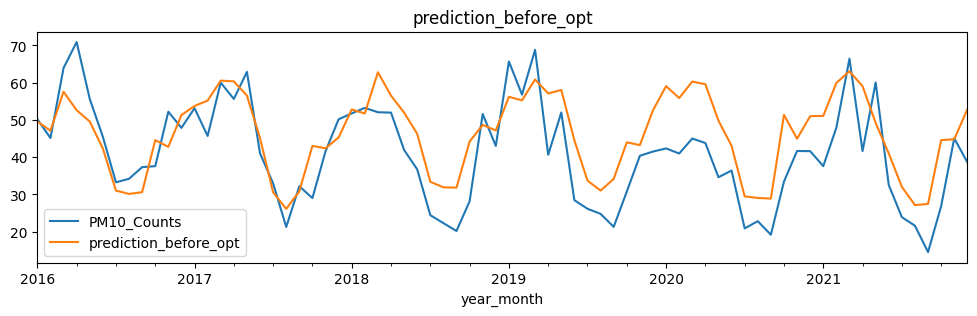

In [33]:
fig = test_df_1.groupby(["year_month"])[["PM10_Counts", "prediction_before_opt"]].mean().plot(figsize=(12, 3))
fig.set_title("prediction_before_opt")
plt.show()

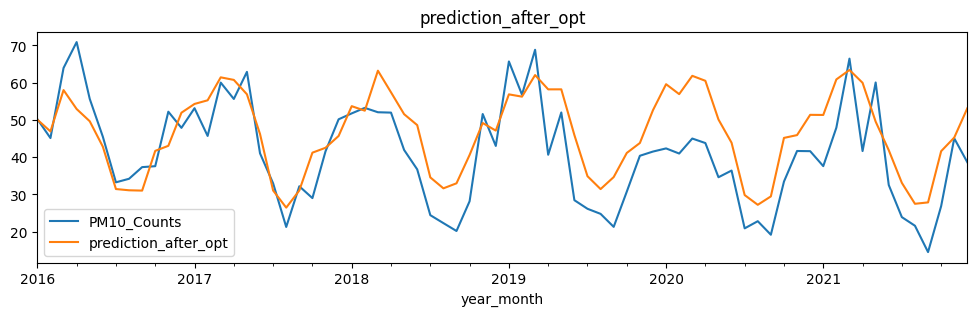

In [34]:
fig = test_df_1.groupby(["year_month"])[["PM10_Counts", "prediction_after_opt"]].mean().plot(figsize=(12, 3))
fig.set_title("prediction_after_opt")
plt.show()

## 6.3. Check on Prediction Error(MAPE)

#### Before Hyper Parameter Optimization

In [35]:
mape(np.log(test_df["PM10_Counts"]), np.log(test_df["prediction_before_opt"]))

14.421409181838154

In [36]:
mape(test_df["PM10_Counts"], test_df["prediction_before_opt"])

63.998518684719706

#### After Hyper Parameter Optimization

In [37]:
mape(np.log(test_df["PM10_Counts"]), np.log(test_df["prediction_after_opt"]))

14.405493220788024

In [38]:
mape(test_df["PM10_Counts"], test_df["prediction_after_opt"])

63.70368970180089

## 6.4 Model Save

In [39]:
joblib.dump(pipe_lgbm_after, "../models/lgbm_model.pkl")

['../models/lgbm_model.pkl']